# GAN using fieldstone binary image data
Modified from reference code: https://pytorch.org/tutorials/beginner/dcgan_faces_tutorial.html

Image dataset used: https://www.digitalrocksportal.org/projects/297/origin_data/1257/

In [1]:
# Set up:
import cv2 
import argparse
import os
import random
import torch
import torch.nn as nn
import torch.nn.parallel
import torch.nn.functional as F
import torch.optim as optim
import torch.utils.data
import torchvision.datasets as dset
import torchvision.transforms as transforms
import torchvision.utils as vutils
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from IPython.display import HTML
from torch import Tensor
import time


# Set random seed for reproducibility
manualSeed = 999
# manualSeed = random.randint(1, 10000)  # Use if you want new results
print("Random Seed: ", manualSeed)
random.seed(manualSeed)
torch.manual_seed(manualSeed)
torch.use_deterministic_algorithms(True)  # Needed for reproducible results

# Check CUDA and GPU
print(torch.cuda.is_available())
print(torch.cuda.get_device_name(0))
device = torch.device("cuda")



Random Seed:  999
True
NVIDIA GeForce RTX 3060 Laptop GPU


In [2]:
# Define inputs

# Root directory for dataset
dataroot = r"C:\Users\johna\Downloads\research\trainingdata"

# Number of workers for dataloader
workers = 2

# Batch size during training
batch_size = 128

# Spatial size of training images. All images will be resized to this
#   size using a transformer. 64 for color, 28 for grayscale
image_size = 28

# Number of channels in the training images. For color images this is 3
nc = 1

# Size of z latent vector (i.e. size of generator input)
nz = 100

# Size of feature maps in generator
ngf = 64

# Size of feature maps in discriminator
ndf = 64

# Number of training epochs
num_epochs = 100

# Learning rate for optimizers --generator and discriminator--
lrg = 1.5e-3 # generator
lrd = 5e-3 # discriminator

# Beta1 hyperparameter for Adam optimizers, should be 0.5
beta1 = 0.5

# Number of GPUs available. Use 0 for CPU mode.
ngpu = 1

# Parameters for Wasserstein Loss:
clip_value = 0.01  # Clipping value for discriminator weights
n_critic = 5  # Number of discriminator updates per generator update


Batch 0: torch.Size([128, 1, 28, 28])
Batch 1: torch.Size([128, 1, 28, 28])
Batch 2: torch.Size([128, 1, 28, 28])
Batch 3: torch.Size([116, 1, 28, 28])


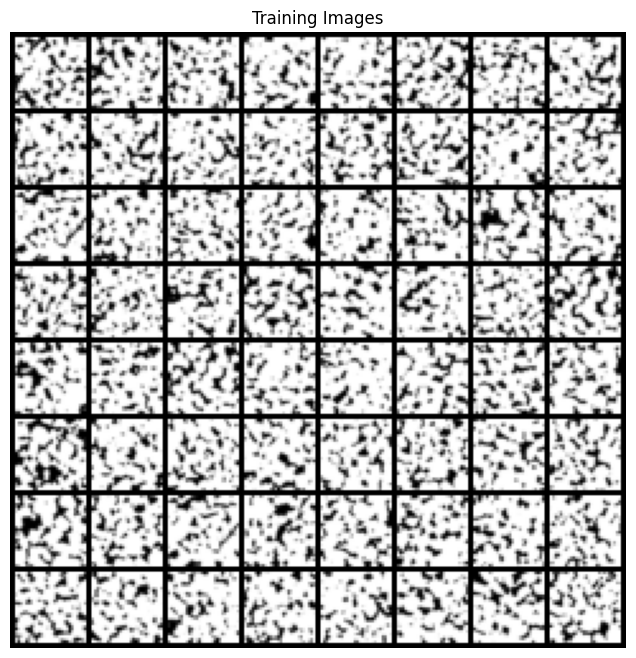

In [3]:

# Create the dataset
dataset = dset.ImageFolder(root=dataroot,
                           transform=transforms.Compose([
                               transforms.Resize(image_size),
                               transforms.CenterCrop(image_size),
                               transforms.Grayscale(num_output_channels=1),
                               transforms.ToTensor(),
                               transforms.Normalize((0.5,), (0.5,)),
                           ]))
# Create the dataloader
dataloader = torch.utils.data.DataLoader(dataset, batch_size=batch_size,
                                         shuffle=True, num_workers=workers)
for i, data in enumerate(dataloader, 0):
    print(f"Batch {i}: {data[0].shape}")  # Check the shape of your input data
# Decide which device we want to run on
device = torch.device("cuda:0" if (torch.cuda.is_available() and ngpu > 0) else "cpu")

# Plot some training images
real_batch = next(iter(dataloader))
plt.figure(figsize=(8,8))
plt.axis("off")
plt.title("Training Images")
plt.imshow(np.transpose(vutils.make_grid(real_batch[0].to(device)[:64], padding=2, normalize=True).cpu(),(1,2,0)))
#plt.savefig("dataset3.png")
plt.show()

In [4]:
# Initializing weights

# custom weights initialization called on ``netG`` and ``netD``
def weights_init(m):
    classname = m.__class__.__name__
    if classname.find('Conv') != -1:
        nn.init.normal_(m.weight.data, 0.0, 0.02)
    elif classname.find('BatchNorm') != -1:
        nn.init.normal_(m.weight.data, 1.0, 0.02)
        nn.init.constant_(m.bias.data, 0)



In [5]:
# Generator with Residual Block

class ResidualBlock(nn.Module):
    def __init__(self, in_channels: int, out_channels: int) -> None:
        super().__init__()
        self.conv1 = nn.Conv2d(
            in_channels=in_channels, 
            out_channels=out_channels, 
            kernel_size=(3, 3), 
            padding='same', 
            bias=False
        )
        self.bn1 = nn.BatchNorm2d(out_channels)
        self.relu = nn.ReLU()
        self.conv2 = nn.Conv2d(
            in_channels=out_channels, 
            out_channels=out_channels, 
            kernel_size=(3, 3), 
            padding='same', 
            bias=False
        )
        self.bn2 = nn.BatchNorm2d(out_channels)
        
        self.downsample = None
        if in_channels != out_channels:
            self.downsample = nn.Sequential(
                nn.Conv2d(
                    in_channels, 
                    out_channels, 
                    kernel_size=(3, 3), 
                    padding='same', 
                    bias=False
                ),
                nn.BatchNorm2d(out_channels)
            )

    def forward(self, x: Tensor) -> Tensor:
        identity = self.downsample(x) if self.downsample else x
        
        x = self.conv1(x)
        x = self.bn1(x)
        x = self.relu(x)
        x = self.conv2(x)
        x = self.bn2(x)
        x = self.relu(x + identity)

        return x


class Generator(nn.Module):
    def __init__(self, ngpu, nz, ngf, nc):
        super(Generator, self).__init__()
        self.ngpu = ngpu
        self.main = nn.Sequential(
            nn.ConvTranspose2d(nz, ngf * 8, 4, 1, 0, bias=False),
            nn.BatchNorm2d(ngf * 8),
            nn.ReLU(True),
            ResidualBlock(ngf * 8, ngf * 8),
            
            nn.ConvTranspose2d(ngf * 8, ngf * 4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf * 4),
            nn.ReLU(True),
            ResidualBlock(ngf * 4, ngf * 4),
            
            nn.ConvTranspose2d(ngf * 4, ngf * 2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf * 2),
            nn.ReLU(True),
            ResidualBlock(ngf * 2, ngf * 2),
            
            nn.ConvTranspose2d(ngf * 2, ngf, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf),
            nn.ReLU(True),
            ResidualBlock(ngf, ngf),
            
            nn.ConvTranspose2d(ngf, nc, 4, 2, 1, bias=False),
            nn.Tanh()
        )

    def forward(self, input):
        x = self.main(input)
        return F.interpolate(x, size=(28, 28), mode='bilinear', align_corners=False)

In [6]:
# Discriminator
# Outputs a probability using Sigmoid function

class Discriminator(nn.Module):
    def __init__(self, ngpu, nc, ndf):
        super(Discriminator, self).__init__()
        self.ngpu = ngpu
        self.main = nn.Sequential(
            # input is (nc) x 28 x 28
            nn.Conv2d(nc, ndf, 4, 2, 1, bias=False),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (ndf) x 14 x 14
            nn.Conv2d(ndf, ndf * 2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 2),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (ndf*2) x 7 x 7
            nn.Conv2d(ndf * 2, ndf * 4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 4),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (ndf*4) x 3 x 3
            nn.Conv2d(ndf * 4, 1, 3, 1, 0, bias=False),
            nn.Sigmoid()
            # output size. 1 x 1 x 1 (probability)
        )

    def forward(self, input):
        return self.main(input)


In [7]:
def get_clean_gan():
    netG = Generator(ngpu, nz, ngf, nc).to(device)
    # Apply the weights_init function to randomly initialize all weights to mean=0, stdev=0.02.
    netG.apply(weights_init)
    
    netD = Discriminator(ngpu, nc, ndf).to(device)
    # Apply the weights_init function to randomly initialize all weights to mean=0, stdev=0.2.
    netD.apply(weights_init)
    
    return netG, netD

# Instantiate the models
netG, netD = get_clean_gan()

# Print the model architectures
print(netG)
print(netD)

Generator(
  (main): Sequential(
    (0): ConvTranspose2d(100, 512, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (1): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU(inplace=True)
    (3): ResidualBlock(
      (conv1): Conv2d(512, 512, kernel_size=(3, 3), stride=(1, 1), padding=same, bias=False)
      (bn1): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU()
      (conv2): Conv2d(512, 512, kernel_size=(3, 3), stride=(1, 1), padding=same, bias=False)
      (bn2): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    )
    (4): ConvTranspose2d(512, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (5): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (6): ReLU(inplace=True)
    (7): ResidualBlock(
      (conv1): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=same, bias=False)
      (bn

In [8]:
def get_hybrid_gan(use_topk_discriminator=False):
    # Initialize generator without Top-K
    netG = Generator(ngpu, nz, ngf, nc).to(device)
    netG.apply(weights_init)  # Apply weights initialization for the generator
    
    # Initialize discriminator with Top-K configuration if needed
    netD = Discriminator(ngpu, nc, ndf).to(device)
    if use_topk_discriminator:
        # Apply Top-K specific weights initialization if needed
        netD.apply(weights_init)
    
    return netG, netD

In [9]:
# Create a batch of noise vectors
noise = torch.randn(16, nz, 1, 1, device=device)

# Generate a batch of images
fake_images = netG(noise)
print(fake_images.size())  # Should output: torch.Size([16, 1, 28, 28])

# Pass fake images through discriminator
output = netD(fake_images)
print(output.size())  # Should output: torch.Size([16, 1, 1, 1])


torch.Size([16, 1, 28, 28])
torch.Size([16, 1, 1, 1])


In [10]:
def train_gan(netG, netD, n_epoch, batch_size, dataloader, criterionD, criterionG, optimizerD, optimizerG, fixed_noise, real_label, fake_label, device, topk=False, hybrid=False):
    # Losses and image list for tracking
    G_losses = []
    D_losses = []
    img_list = []

    # Timer
    start_time = time.time()

    # Training Loop
    for epoch in range(n_epoch):
        for i, data in enumerate(dataloader, 0):
            # Update Discriminator
            netD.zero_grad()
            real_cpu, _ = data
            batch_size = real_cpu.size(0)
            label = torch.full((batch_size,), real_label, dtype=torch.float, device=device)
            output = netD(real_cpu.to(device)).view(-1)
            errD_real = criterionD(output, label)
            errD_real.backward()
            D_x = output.mean().item()

            noise = torch.randn(batch_size, nz, 1, 1, device=device)
            fake = netG(noise)
            label.fill_(fake_label)
            output = netD(fake.detach()).view(-1)
            errD_fake = criterionD(output, label)
            errD_fake.backward()
            D_G_z1 = output.mean().item()
            errD = errD_real + errD_fake
            optimizerD.step()

            # Update Generator with BCE loss
            netG.zero_grad()
            label.fill_(real_label)  # Real labels for the generator's goal
            output = netD(fake).view(-1)
            errG = criterionG(output, label)
            errG.backward()
            D_G_z2 = output.mean().item()
            optimizerG.step()

            # Print and save losses
            if i % 1 == 0:
                print(f'[{epoch}/{n_epoch}] [{i}/{len(dataloader)}] Loss_D: {errD.item()} Loss_G: {errG.item()} D(x): {D_x} D(G(z)): {D_G_z1} / {D_G_z2}')
                G_losses.append(errG.item())
                D_losses.append(errD.item())

            # Save generated images
            if (i == len(dataloader) - 1) or (epoch == n_epoch - 1):
                with torch.no_grad():
                    fake = netG(fixed_noise).detach().cpu()
                img_list.append(vutils.make_grid(fake, padding=2, normalize=True))

    # Timer end
    end_time = time.time()
    elapsed_time = end_time - start_time
    print(f"\nTraining Complete! :D \nElapsed time: {elapsed_time:.2f} seconds")

    return G_losses, D_losses, img_list

In [11]:
print("-------HYBRID TRAINING-------------")
netG, netD = get_hybrid_gan(use_topk_discriminator=True)

# Define loss functions and other parameters
criterionD = nn.BCELoss()
criterionG = nn.BCELoss() 
fixed_noise = torch.randn(64, nz, 1, 1, device=device)
real_label = 1.0
fake_label = 0.0
optimizerD = optim.Adam(netD.parameters(), lr=lrd, betas=(beta1, 0.999))
optimizerG = optim.Adam(netG.parameters(), lr=lrg, betas=(beta1, 0.999))

# Call training function
G_losses_hybrid, D_losses_hybrid, img_list_hybrid = train_gan(
    netG, netD, n_epoch=num_epochs, batch_size=batch_size,
    dataloader=dataloader, criterionD=criterionD, criterionG=criterionG,
    optimizerD=optimizerD, optimizerG=optimizerG, fixed_noise=fixed_noise,
    real_label=real_label, fake_label=fake_label, device=device, topk=False, hybrid=True
)


-------HYBRID TRAINING-------------


[0/100] [0/4] Loss_D: 1.3117225170135498 Loss_G: 19.412883758544922 D(x): 0.5251550674438477 D(G(z)): 0.4620126485824585 / 9.76889147352722e-09
[0/100] [1/4] Loss_D: 7.842227935791016 Loss_G: 17.763954162597656 D(x): 0.9891991019248962 D(G(z)): 0.999593198299408 / 1.1874948313561617e-06
[0/100] [2/4] Loss_D: 2.7157211303710938 Loss_G: 9.576294898986816 D(x): 0.4510834217071533 D(G(z)): 0.03033958375453949 / 0.017433883622288704
[0/100] [3/4] Loss_D: 14.09263801574707 Loss_G: 0.436092734336853 D(x): 0.8920497298240662 D(G(z)): 0.999998927116394 / 0.6496847867965698
[1/100] [0/4] Loss_D: 6.603533744812012 Loss_G: 5.519402503967285 D(x): 0.8899052143096924 D(G(z)): 0.9981930255889893 / 0.004105216823518276
[1/100] [1/4] Loss_D: 2.437486410140991 Loss_G: 8.343329429626465 D(x): 0.6779137849807739 D(G(z)): 0.7767244577407837 / 0.00024574261624366045
[1/100] [2/4] Loss_D: 3.6118760108947754 Loss_G: 6.745759010314941 D(x): 0.4353073835372925 D(G(z)): 0.7403327226638794 / 0.0017113062785938382

In [12]:
# # Wasserstein Training Loop

# def train_gan(netG, netD, n_epoch, batch_size, dataloader, optimizerD, optimizerG, fixed_noise, device):
#     G_losses = []
#     D_losses = []
#     img_list = []

#     start_time = time.time()

#     for epoch in range(n_epoch):
#         for i, data in enumerate(dataloader, 0):
#             # Update Discriminator
#             netD.zero_grad()
#             real_cpu, _ = data
#             real_imgs = real_cpu.to(device)

#             # Train with real images
#             real_output = netD(real_imgs)
#             D_x = real_output.mean().item()

#             # Train with fake images
#             noise = torch.randn(batch_size, nz, 1, 1, device=device)
#             fake_imgs = netG(noise)
#             fake_output = netD(fake_imgs.detach())
#             D_G_z1 = fake_output.mean().item()

#             # Wasserstein Loss
#             discriminator_loss = torch.mean(fake_output) - torch.mean(real_output)
#             discriminator_loss.backward()
#             optimizerD.step()

#             # Clip weights of discriminator
#             for p in netD.parameters():
#                 p.data.clamp_(clip_value, clip_value)

#             # Update Generator every n_critic steps
#             if i % n_critic == 0:
#                 netG.zero_grad()
#                 fake_output = netD(fake_imgs)
#                 generator_loss = -torch.mean(fake_output)
#                 generator_loss.backward()
#                 optimizerG.step()

#             # Print and save losses
#             if i % 1 == 0:
#                 print(f'[{epoch}/{n_epoch}] [{i}/{len(dataloader)}] Loss_D: {discriminator_loss.item()} Loss_G: {generator_loss.item()} D(x): {D_x} D(G(z)): {D_G_z1}')
#                 G_losses.append(generator_loss.item())
#                 D_losses.append(discriminator_loss.item())

#             # Save generated images
#             if (i == len(dataloader) - 1) or (epoch == n_epoch - 1):
#                 with torch.no_grad():
#                     fake = netG(fixed_noise).detach().cpu()
#                 img_list.append(vutils.make_grid(fake, padding=2, normalize=True))

#     end_time = time.time()
#     elapsed_time = end_time - start_time
#     print(f"Elapsed time: {elapsed_time:.2f} seconds")

#     return G_losses, D_losses, img_list

In [13]:
# # Training with Wasserstein

# print("-------HYBRID TRAINING-------------")
# netG, netD = get_hybrid_gan(use_topk_discriminator=True)

# # Define parameters
# fixed_noise = torch.randn(64, nz, 1, 1, device=device)
# optimizerD = optim.Adam(netD.parameters(), lr=lrd, betas=(beta1, 0.999))
# optimizerG = optim.Adam(netG.parameters(), lr=lrd, betas=(beta1, 0.999))

# # Call training function
# G_losses_hybrid, D_losses_hybrid, img_list_hybrid = train_gan(
#     netG, netD, n_epoch=num_epochs, batch_size=batch_size,
#     dataloader=dataloader, optimizerD=optimizerD, optimizerG=optimizerG,
#     fixed_noise=fixed_noise, device=device
# )


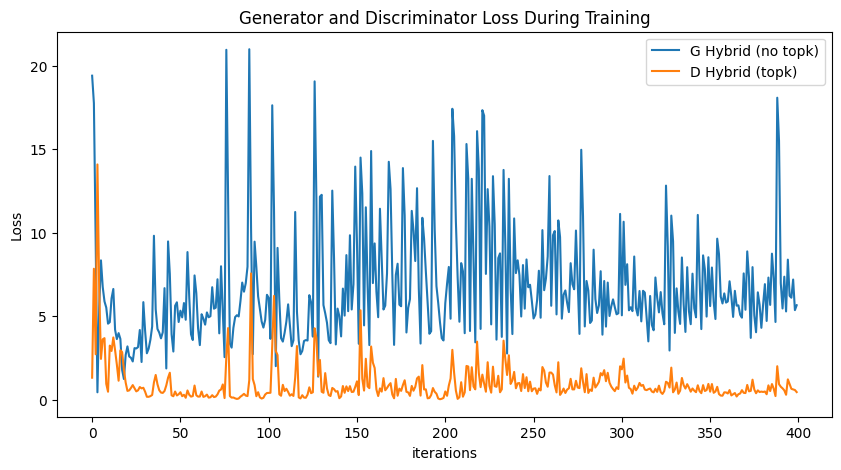

In [14]:
# Visualize training

plt.figure(figsize=(10,5))
plt.title("Generator and Discriminator Loss During Training")
plt.plot(G_losses_hybrid, label="G Hybrid (no topk)")
plt.plot(D_losses_hybrid, label="D Hybrid (topk)")
plt.xlabel("iterations")
plt.ylabel("Loss")
plt.legend()
#plt.savefig("hybrid_data6.png")

plt.show()

Animation size has reached 21179657 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


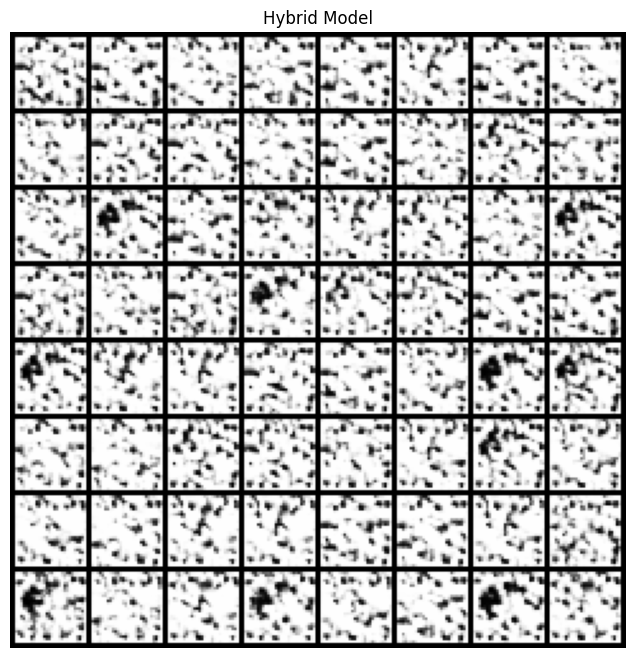

In [15]:
#%%capture
fig = plt.figure(figsize=(8,8))
plt.axis("off")
plt.title("Hybrid Model")
ims = [[plt.imshow(np.transpose(i,(1,2,0)), animated=True)] for i in img_list_hybrid]
ani = animation.ArtistAnimation(fig, ims, interval=1000, repeat_delay=1000, blit=True)

HTML(ani.to_jshtml())


# **Notes:**

## 8/19/24
Some changes that I made include:
* Added more layers to the Generator architecture
* 5 vs 10 epochs did not change much (but that may be due to issues with generator)
* Made learning rate for Generator and Discriminator seperate values
    * Manipulated different values/ratios of learning rates
* Implemented top k training (results for first round of testing are displayed for both with and without top k)
![Training Loss w/wo Top k](training_w_topk_plot.png)
    * Generator LR: 0.0002, Discriminator LR: 0.0003
    * What if I used top k training on the discriminator and regular training on the generator?
    * Need to improve Generator
* Introduced a hybrid training
    * Generator w/ regular training
    * Discrimiantor w/ top k training   
     
![Training w/ Hybrid](training_w_hybrid_plot.png)

* Still Not that great
****
* First dataset tested:

![Dataset 1](dataset1.png)

* Second dataset tested:

![Dataset 2](dataset3.png)
![Hybrid Training 2](hybrid_data2.png)
* Somehow, the Generator loss did decrease
****
## Things to try:
* Decrease generator learning rate to 1e-5
* Grid search for feature map
* Use random data/noise on discriminator
* Residual blocks
* More epochs
* Generator loss function
* More complex generator architecture

****

## 8/26/24

Changes:
* Changed gen and disc learning rates to 1e-5 and 5e-5, respectively
* Increased num of epochs to 100 (400 iterations)

![Second Version after Improvements](hybrid_data3.png)
* Generator starts to worsen after ~125 iterations (~30 epochs)

* Introduced residual block to generator
* Changed gen and disc learning rates to 1e-4 and 5e-4, respectively

![Third Version after Improvements](hybrid_data4.png)

* Changed learning rates to 1e-3 and 5e-3

![Fourth Version after Improvements](hybrid_data5.png)

* Used MSE loss function for generator, BCE loss function for discriminator
    * Led to disc loss = 1, gen loss = 0
    * Tried MSE for both, similar result

![Fifth Version after Improvements](hybrid_data6.png)

* Changed generator learning rate to ~~2e-5~~ 1.5e-5
    * Currently best looking results

![Sixth Version after Improvements](hybrid_data7.png)

* Wasserstein Loss

![Wasserstein implementation](wassersteinresult.png)
